<h1>Final Project</h1>


<p>Address Food Insecurities in Las Vegas</p>
<p>Inspired by <a href="https://toogoodtogo.com/en">Too Good To Go</a>

<h2>Introduction/Business Problem</h2>
<p>The problem I would like to solve is the excess of Food Waste in the United States. United States has 126 million tons each year of foodwaste(415 kg per capita) (CEC, 2017). Everyone should care about this problem but the main stakeholders would be people in need of food, businesses that have food waste, potential food bank partners and volunteers, people who wish to donate, and companies like Uber, Postmates, and Grubhub with a lot of delivery drivers. My goal is to show the potential in a specific area by using Foursquare location data about businesses in a designated location. This project aims to take ideas from Too Good To Go and implement it in the most food insecure area in the Las Vegas Valley, zip code 89106, West Las Vegas. The Too Good To Go App helps fight food waste and states "Through our app, we connect our users with delicious unsold food from a variety of shops and restaurants all over Europe." I want to show that this can be viable based on the types of businesses near this area of Las Vegas as a test case for hopefully further implementation throughout the Las Vegas Valley and the country. The overall goal would also provide the businesses, companies and delivery drivers, tax write offs and perhaps other benefits for all the orders they provide. I am only using one location for purposes of demonstrating potential.</p>

<h1>Data</h1>
<p> I am taking the data from Three Square that found this location (89106) as the most food insecure in Las Vegas and will analyze that location through the Foursquare API to determine businesses that might be interested in this type of program. I also feel that this could be taken to another level by allowing delivery drivers from Uber Eats, Postmates, and Grubhub to help facilitate deliveries to users as well. I do however, not believe I will have access to the number of delivery drivers and other data from those companies but hopefully will after this first process to better enrich the viability of the delivery driver idea. </p>

<h1>Methodology</h1>
<p>Methodology section which represents the main component of the report where you discuss and describe any exploratory data analysis that you did, any inferential statistical testing that you performed, if any, and what machine learnings were used and why.</p>

<h1>Results</h1>
<p>Results section where you discuss the results.</p>

<h1>Discussion</h1>
<p>Discussion section where you discuss any observations you noted and any recommendations you can make based on the results.</p>

<h1>Conclusion</h1>
<p>Conclusion section where you conclude the report.</p>

<p> Import Packages</p>

In [217]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


<p> Read in data </p>

In [104]:
df = pd.read_csv('foodthreesquare.csv')

In [105]:
df

,ZipCode,PercentageInsecurities,City,Neighborhood,Latitude,Longitude,TotalPopulation,ApproxInNeed
0,89106,25.5,"Las Vegas, NV",Bonanza Village | West Las Vegas,36.18102,-115.16396,"25,759",6569


In [106]:
df.shape

(1, 8)

In [52]:
# df.columns.tolist()
# df.rename(columns={'location.1':'location_type'}, inplace=True)

<h1> West Las Vegas Valley on Map </h1>

In [107]:
address = '89106'

geolocator = Nominatim(user_agent="vegas_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of West Las Vegas is {}, {}.'.format(latitude, longitude))

The geograpical coordinate of West Las Vegas is 36.167241238029, -115.163725782405.


<p>Create a map of West Las Vegas </p>

In [110]:
# create map of West Las Vegas using latitude and longitude values
map_usa = folium.Map(location=[latitude, longitude], zoom_start=12)

# add markers to map
for lat, lng, city, neighborhood, foodinsecurities, totalpop, amntneed in zip(df['Latitude'], df['Longitude'], df['City'], df['Neighborhood'], df['PercentageInsecurities'], df['TotalPopulation'], df['ApproxInNeed']):
    label = 'City: {}\n, Neighborhood: {}\n, Total Population: {}\n, Food Insecurities Percentage: {}\n, Amount in Need: {}\n'.format(city, neighborhood, totalpop, foodinsecurities, amntneed)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

<h1> Foursquare Credentials </h1>

In [69]:
CLIENT_ID = 'AKCHGOQTMSIPHHI4V4J4DNUDEYRHIHEBVWCJ4N1DAXNUWRGZ' # your Foursquare ID
CLIENT_SECRET = 'HM2OPJAHE0OB1BRPQYCR11GTGQ5XFDADU51NKBC20GDHTA4H' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: AKCHGOQTMSIPHHI4V4J4DNUDEYRHIHEBVWCJ4N1DAXNUWRGZ
CLIENT_SECRET:HM2OPJAHE0OB1BRPQYCR11GTGQ5XFDADU51NKBC20GDHTA4H


<p>Get Category Type from Foursquare </p>

<p>Food results Query</p>

In [351]:
# type your answer here

LIMIT = 50 # limit of number of venues returned by Foursquare API


query = 'Food' #



 # create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&limit={}&query={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude,  
    LIMIT,
    query)
url # display URL


'https://api.foursquare.com/v2/venues/explore?&client_id=AKCHGOQTMSIPHHI4V4J4DNUDEYRHIHEBVWCJ4N1DAXNUWRGZ&client_secret=HM2OPJAHE0OB1BRPQYCR11GTGQ5XFDADU51NKBC20GDHTA4H&v=20180605&ll=36.167241238029,-115.163725782405&limit=50&query=Food'

<p>Function that extracts the category of the venue</p>

In [352]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

<p>Show Query Results</p>

In [353]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5d754d249ba3e5002c8208c6'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': '$-$$$$', 'key': 'price'},
    {'name': 'Open now', 'key': 'openNow'}]},
  'suggestedRadius': 2006,
  'headerLocation': 'Las Vegas',
  'headerFullLocation': 'Las Vegas',
  'headerLocationGranularity': 'city',
  'query': 'food',
  'totalResults': 100,
  'suggestedBounds': {'ne': {'lat': 36.17560669793198,
    'lng': -115.14005040803968},
   'sw': {'lat': 36.151039565006215, 'lng': -115.17641287210336}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '554183f6498e26c4eb31f35b',
       'name': 'The Cheesecake Factory',
       'location': {'address': '505 S Grand Central Pkwy',
        'crossStreet': 'at W Bonneville Ave',
    

<p>Create dataframe from results</p>

In [354]:
venuesf = results['response']['groups'][0]['items']
    
dffood = json_normalize(venuesf) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng','venue.location.postalCode']
dffood = dffood.loc[:, filtered_columns]

# filter the category for each row
dffood['venue.categories'] = dffood.apply(get_category_type, axis=1)

# clean columns
dffood.columns = [col.split(".")[-1] for col in dffood.columns]

dffood.head()

,name,categories,lat,lng,postalCode
0,The Cheesecake Factory,American Restaurant,36.166072,-115.157329,89106
1,Lola's - A Louisiana Kitchen,Cajun / Creole Restaurant,36.158569,-115.157928,89102
2,Omelet House,Breakfast Spot,36.159703,-115.171390,89102
3,Chipotle Mexican Grill,Mexican Restaurant,36.163280,-115.158879,89106
4,Real Donuts #1,Donut Shop,36.158606,-115.166319,89102


<p>Query Loop for different food categories and store in dataframe</p>

In [355]:
search_query = ['Food','American Restaurant','Mexican Restaurant', 'Afghan Restaurant','African Restaurant', 
                'Ethiopian Restaurant', 'American Restaurant', 'New American Restaurant', 'Asian Restaurant',
                'Chinese Restaurant', 'Filipino Restaurant', 'Japanese Restaurant', 'Korean Restaurant', 
                'Thai Restaurant', 'BBQ Joint', 'Bagel Shop', 'Bakery', 'Bistro', 'Breakfast Spot', 
                'Bubble Tea Shop', 'Buffet', 'Burger Joint', 'Cafeteria', 'Café', 'Cajun / Creole Restaurant',
                'Caribbean Restaurant', 'Coffee Shop', 'Deli / Bodega', 'Dessert Shop', 'Diner', 'Donut Shop',
                'English Restaurant', 'Falafel Restaurant', 'Fast Food Restaurant', 'Food Truck', 'French Restaurant'
                'Fried Chicken Joint', 'Gastropub', 'German Restaurant', 'Greek Restaurant', 'Halal Restaurant',
                'Hawaiian Restaurant', 'Hot Dog Joint', 'Indian Restaurant', 'Irish Pub', 'Italian Restaurant', 
                'Jewish Restaurant', 'Juice Bar', 'Kebab Restaurant', 'Latin American Restaurant', 
                'Mediterranean Restaurant', 'Middle Eastern Restaurant', 'Pizza Place', 'Polish Restaurant', 
                'Portuguese Restaurant', 'Restaurant', 'Russian Restaurant', 'Salad Place',
                'Sandwich Place', 'Scandinavian Restaurant', 'Seafood Restaurant',
                'Snack Place', 'Soup Place', 'Southern / Soul Food Restaurant', 'Spanish Restaurant', 'Steakhouse',
                'Turkish Restaurant', 'Vegetarian / Vegan Restaurant', 'Wings Joint', 'Food & Drink Shop', 'Butcher',
                'Gourmet Shop', 'Organic Grocery', 'Supermarket', 'Fruit & Vegetable Store', 'Gas Station',
                'Grocery Store']
LIMIT = 50 # limit of number of venues returned by Foursquare API


for i in search_query:
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&query={}&limit={}'.format(
        CLIENT_ID,
        CLIENT_SECRET,
        latitude,
        longitude,
        VERSION, 
        i,
        LIMIT)
    print(url)
    results = requests.get(url).json()
    print(results)
    venuesf = results['response']['groups'][0]['items']
    print(venuesf)
    
    nearby_venuesf = json_normalize(venuesf) # flatten JSON
    print(nearby_venuesf)

    # filter columns
    filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng', 'venue.location.postalCode']
    print(filtered_columns)
    nearby_venuesf = nearby_venuesf.loc[:, filtered_columns]
    print(nearby_venuesf)

    # filter the category for each row
    nearby_venuesf['venue.categories'] = nearby_venuesf.apply(get_category_type, axis=1)
    print(nearby_venuesf)

    # clean columns
    nearby_venuesf.columns = [col.split(".")[-1] for col in nearby_venuesf.columns]
    print(nearby_venuesf)

    dffood = dffood.append(nearby_venuesf[['name','categories', 'lat', 'lng', 'postalCode']])
    print(dffood)
    search_query=search_query[+1:+1]
    

https://api.foursquare.com/v2/venues/explore?client_id=AKCHGOQTMSIPHHI4V4J4DNUDEYRHIHEBVWCJ4N1DAXNUWRGZ&client_secret=HM2OPJAHE0OB1BRPQYCR11GTGQ5XFDADU51NKBC20GDHTA4H&ll=36.167241238029,-115.163725782405&v=20180605&query=Food&limit=50
{'meta': {'code': 200, 'requestId': '5d754d49b9961d002b67c79b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'food', 'totalResults': 100, 'suggestedBounds': {'ne': {'lat': 36.17560669793198, 'lng': -115.14005040803968}, 'sw': {'lat': 36.151039565006215, 'lng': -115.17641287210336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e

{'meta': {'code': 200, 'requestId': '5d754d4a23bb8e0038575fc2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'american restaurant', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 36.17514871627188, 'lng': -115.1234510800446}, 'sw': {'lat': 36.12244295829052, 'lng': -115.21169654725365}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e26c4eb31f35b', 'name': 'The Cheesecake Factory', 'location': {'address': '505 S Grand Central Pkwy', 'crossStreet': 'at W Bonneville Ave', 'lat': 36.16607248219752, 'lng': -115.15732938759368, 'labeledLatLngs': [{'label': 

{'meta': {'code': 200, 'requestId': '5d754d4ba30619002c23b8f7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'mexican restaurant', 'totalResults': 103, 'suggestedBounds': {'ne': {'lat': 36.198991037039995, 'lng': -115.11456568973776}, 'sw': {'lat': 36.12131115863982, 'lng': -115.21310693868205}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56ca445c498edfac007dc8c9', 'name': 'Chipotle Mexican Grill', 'location': {'address': '875 S Grand Central Pkwy Ste 1660', 'lat': 36.16328, 'lng': -115.158879, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16328, 'lng': -115.15887

{'meta': {'code': 200, 'requestId': '5d754d4b724750002cb9a500'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Afghan Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'afghan restaurant', 'totalResults': 2, 'suggestedBounds': {'ne': {'lat': 36.1481311820976, 'lng': -115.11441524783402}, 'sw': {'lat': 36.09732917595055, 'lng': -115.19558032153174}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '581a38c5eb569a2b73aced03', 'name': 'Pro Kabob Persian Restaurant', 'location': {'address': '3854 W Sahara Ave', 'lat': 36.145822, 'lng': -115.191891, 'labeledLatLngs': [{'label': 'display', 'lat': 36.145822, 'lng': -115.

{'meta': {'code': 200, 'requestId': '5d754d4ca19793003897bf86'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'african restaurant', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 36.15991455, 'lng': -115.13521470740973}, 'sw': {'lat': 36.09660845, 'lng': -115.33957510917098}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4aa9baf964a520778c26e3', 'name': 'Merkato Ethiopian Cafe', 'location': {'address': '855 E Twain Ave', 'lat': 36.12146381901963, 'lng': -115.14450381658071, 'labeledLatLngs': [{'label': 'display', 'lat': 36.12146381901963, 'lng': -115.14450381658071}], 'distance': 5380, 'postalCode': '89169', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'formattedAddr

{'meta': {'code': 200, 'requestId': '5d754d4ca30619002c23c43a'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'ethiopian restaurant', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 36.132027599999994, 'lng': -115.14015155740974}, 'sw': {'lat': 36.0979364, 'lng': -115.23590125917097}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4aa9baf964a520778c26e3', 'name': 'Merkato Ethiopian Cafe', 'location': {'address': '855 E Twain Ave', 'lat': 36.12146381901963, 'lng': -115.14450381658071, 'labeledLatLngs': [{'label': 'display', 'lat': 36.12146381901963, 'lng': -115.14450381658071}], 'distance': 5380, 'postalCode': '89169', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'forma

{'meta': {'code': 200, 'requestId': '5d754d4db9961d002b67e03d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'american restaurant', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 36.17514871627188, 'lng': -115.1234510800446}, 'sw': {'lat': 36.12244295829052, 'lng': -115.21169654725365}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e26c4eb31f35b', 'name': 'The Cheesecake Factory', 'location': {'address': '505 S Grand Central Pkwy', 'crossStreet': 'at W Bonneville Ave', 'lat': 36.16607248219752, 'lng': -115.15732938759368, 'labeledLatLngs': [{'label': 

{'meta': {'code': 200, 'requestId': '5d754d4e0d2be7002c71da56'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'new american restaurant', 'totalResults': 12, 'suggestedBounds': {'ne': {'lat': 36.1750348171446, 'lng': -115.13228907258966}, 'sw': {'lat': 36.12244289146107, 'lng': -115.19906635535884}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55862ca8498ee57011d3d4d8', 'name': 'Therapy', 'location': {'address': '518 Fremont St', 'crossStreet': 'Las Vegas Boulevard', 'lat': 36.16908745564181, 'lng': -115.13988398841154, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16908745564181, 'lng': -115.139883988

{'meta': {'code': 200, 'requestId': '5d754d4f6e4650002c930771'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'asian restaurant', 'totalResults': 132, 'suggestedBounds': {'ne': {'lat': 36.19960822771664, 'lng': -115.13409213709375}, 'sw': {'lat': 36.12108521795061, 'lng': -115.20887660987316}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e56a456a80919b582330be4', 'name': 'Nozomi Japanese Restaurant', 'location': {'address': '2202 W Charleston Blvd', 'lat': 36.15969629427713, 'lng': -115.17205155091843, 'labeledLatLngs': [{'label': 'display', 'lat': 36.15969629427713, '

{'meta': {'code': 200, 'requestId': '5d754d4fe97dfb002c22159e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'chinese restaurant', 'totalResults': 36, 'suggestedBounds': {'ne': {'lat': 36.20206714080347, 'lng': -115.11665993424259}, 'sw': {'lat': 36.12082937424746, 'lng': -115.21207098090525}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '535c18bc498eb25410738b4b', 'name': 'Kung Pao Wok', 'location': {'address': '875 S Grand Central Pkwy #1475', 'lat': 36.16382987672125, 'lng': -115.15783758076194, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16382987672125, 'lng':

{'meta': {'code': 200, 'requestId': '5d754d50be7078002c80d0db'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'filipino restaurant', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 36.20502799669966, 'lng': -115.12760637903251}, 'sw': {'lat': 36.04315206930716, 'lng': -115.3091529460949}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a92e79bf964a520111e20e3', 'name': 'Jollibee', 'location': {'address': '3890 S Maryland Pkwy Ste 137', 'crossStreet': 'btwn E Katie Ave & E Flamingo Rd', 'lat': 36.11817921238204, 'lng': -115.13598918914795, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1181792123820

{'meta': {'code': 200, 'requestId': '5d754d51598e64002c5a48c3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'japanese restaurant', 'totalResults': 32, 'suggestedBounds': {'ne': {'lat': 36.19186237771664, 'lng': -115.130993}, 'sw': {'lat': 36.1214540679506, 'lng': -115.202559}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e56a456a80919b582330be4', 'name': 'Nozomi Japanese Restaurant', 'location': {'address': '2202 W Charleston Blvd', 'lat': 36.15969629427713, 'lng': -115.17205155091843, 'labeledLatLngs': [{'label': 'display', 'lat': 36.15969629427713, 'lng': -115.1720

{'meta': {'code': 200, 'requestId': '5d754d5248b1e10038309b84'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'korean restaurant', 'totalResults': 12, 'suggestedBounds': {'ne': {'lat': 36.17757217316093, 'lng': -115.13445280537111}, 'sw': {'lat': 36.12946903028715, 'lng': -115.19619642054037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b8a987df964a5202c7432e3', 'name': 'E-jo Korean Restaurant', 'location': {'address': '700 E Sahara Ave', 'lat': 36.144205054359325, 'lng': -115.14527614067876, 'labeledLatLngs': [{'label': 'display', 'lat': 36.144205054359325, 'lng': -115.14527614067876}], 'distance': 305

{'meta': {'code': 200, 'requestId': '5d754d5223bb8e003857934e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'thai restaurant', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 36.17234116236721, 'lng': -115.13312881311784}, 'sw': {'lat': 36.12682777868131, 'lng': -115.20856072318485}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50ab4968e4b02adc85e83338', 'name': 'Ocha Cuisine', 'location': {'address': '1201 Las Vegas Blvd S #150', 'crossStreet': 'at Park Paseo', 'lat': 36.15668320362779, 'lng': -115.14869992119385, 'labeledLatLngs': [{'label': 'display', 'lat': 

{'meta': {'code': 200, 'requestId': '5d754d53d0a14900327c806c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'bbq joint', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 36.20149714365513, 'lng': -115.13458882258902}, 'sw': {'lat': 36.12007858324233, 'lng': -115.20984157987672}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5615bf92498ef3e955dd2c8f', 'name': "Rick's Rollin' Smoke BBQ & Tavern", 'location': {'address': '725 Las Vegas Blvd S Ste 110', 'crossStreet': 'Gass Ave.', 'lat': 36.161404073939934, 'lng': -115.14560807769685, 'labeledLatLngs': [{'label': 'dis

{'meta': {'code': 200, 'requestId': '5d754d538afbe0003a898288'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'bagel shop', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 36.27780430000001, 'lng': -115.07068191654591}, 'sw': {'lat': 36.0238297, 'lng': -115.32137433261434}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc7666692b376b01ea54f3a', 'name': 'New York Bagel Deli', 'location': {'address': '840 S Rancho Dr Ste 16', 'crossStreet': 'btwn Palomino Ln & W Charleston Blvd', 'lat': 36.16168258874843, 'lng': -115.173330434869, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16168258874843, 'lng'

{'meta': {'code': 200, 'requestId': '5d754d549ba3e5002c832b7d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'bakery', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 36.3148383571261, 'lng': -115.03393510437031}, 'sw': {'lat': 36.04662688116384, 'lng': -115.29440728791387}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f25a03ee4b06176458995ce', 'name': "Gigi's Cupcakes", 'location': {'address': '1 S Main St', 'crossStreet': 'at Fremont St', 'lat': 36.17152232607216, 'lng': -115.1462146044786, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17152232607216, 'lng

{'meta': {'code': 200, 'requestId': '5d754d552619ee002cdba9b1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'bistro', 'totalResults': 14, 'suggestedBounds': {'ne': {'lat': 36.30138537699593, 'lng': -115.11492912402537}, 'sw': {'lat': 36.106622124904966, 'lng': -115.29422639546726}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e26c4eb31f35b', 'name': 'The Cheesecake Factory', 'location': {'address': '505 S Grand Central Pkwy', 'crossStreet': 'at W Bonneville Ave', 'lat': 36.16607248219752, 'lng': -115.15732938759368, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16607248219752, 'lng': -115

{'meta': {'code': 200, 'requestId': '5d754d56f9dbde0038ebf657'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'breakfast spot', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 36.18779222191114, 'lng': -115.1234510800446}, 'sw': {'lat': 36.12094285545956, 'lng': -115.21169654725365}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a3c3ffaf964a52054a11fe3', 'name': 'Omelet House', 'location': {'address': '2160 W Charleston Blvd', 'crossStreet': 'at S Rancho Dr', 'lat': 36.159702704869744, 'lng': -115.17139029003366, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1

{'meta': {'code': 200, 'requestId': '5d754d57bbed21003896d6c4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'bubble tea shop', 'totalResults': 43, 'suggestedBounds': {'ne': {'lat': 36.29144785899985, 'lng': -115.06454844999999}, 'sw': {'lat': 36.03662496100312, 'lng': -115.32495255}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58a22cf92896a207f946ca4c', 'name': 'Kung Fu Tea', 'location': {'address': '3200 Las Vegas Blvd S Spc 7500', 'lat': 36.127384, 'lng': -115.168947, 'labeledLatLngs': [{'label': 'display', 'lat': 36.127384, 'lng': -115.168947}], 'distance': 4461, 'postalCode': '89109', 'cc': 'US', '

{'meta': {'code': 200, 'requestId': '5d754d58d9a6e600386b6c12'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'buffet', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 36.20069205202713, 'lng': -115.139327446277}, 'sw': {'lat': 36.12103360726915, 'lng': -115.21081667158215}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e57e9b7c65b219786a4207b', 'name': 'Garden Court Buffet', 'location': {'address': '200 N Main St', 'lat': 36.173982450618595, 'lng': -115.14549345443686, 'labeledLatLngs': [{'label': 'display', 'lat': 36.173982450618595, 'lng': -115.14549345443686}]

{'meta': {'code': 200, 'requestId': '5d754d596e4650002c934768'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'burger joint', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 36.20081897718633, 'lng': -115.13299844770027}, 'sw': {'lat': 36.1201108768837, 'lng': -115.20814762238514}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a429c5c0881585592c3aaea', 'name': 'Shake Shack', 'location': {'address': '905 S Grand Central Pkwy #1700', 'lat': 36.16281374983118, 'lng': -115.15925371499362, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16281374983118, 'lng': -115.15

{'meta': {'code': 200, 'requestId': '5d754d5d6001bc0037c225c5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'cafeteria', 'totalResults': 9, 'suggestedBounds': {'ne': {'lat': 36.168278300913165, 'lng': -115.13255147417644}, 'sw': {'lat': 36.12306780967186, 'lng': -115.19651586272693}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d559042cff7721ef446abf5', 'name': 'Valley Hospital Cafe', 'location': {'address': '620 Shadow Ln', 'lat': 36.16345695407839, 'lng': -115.16576292689639, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16345695407839, 'lng': -115.16576292689639}], 'distance': 459, 'postalCode':

{'meta': {'code': 200, 'requestId': '5d754d61d03d29003893150d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'cafe', 'totalResults': 93, 'suggestedBounds': {'ne': {'lat': 36.20154170167714, 'lng': -115.12920649753607}, 'sw': {'lat': 36.12028811832784, 'lng': -115.21098940564195}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '598211341f8ed620586e81c1', 'name': 'AmeriBrunch Cafe', 'location': {'address': '316 E Bridger Ave Ste 102', 'crossStreet': '4th street', 'lat': 36.167681812289956, 'lng': -115.14352351427078, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1676818

{'meta': {'code': 200, 'requestId': '5d754d62db1d81002c764605'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'cajun creole restaurant', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 36.260512356920685, 'lng': -115.03627300207359}, 'sw': {'lat': 36.031550504665546, 'lng': -115.32176263859381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af6274cf964a520c10122e3', 'name': "Lola's - A Louisiana Kitchen", 'location': {'address': '231 W Charleston Blvd', 'lat': 36.1585694842692, 'lng': -115.15792786030543, 'labeledLatLngs': [{'label': 'display', 'lat': 36.158569484

{'meta': {'code': 200, 'requestId': '5d754d63db1d81002c7649e5'}, 'response': {'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'caribbean restaurant', 'totalResults': 10, 'suggestedBounds': {'ne': {'lat': 36.19579465, 'lng': -115.11874949999999}, 'sw': {'lat': 36.13607235, 'lng': -115.2118205}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4542fff964a520560926e3', 'name': 'Florida Cafe Cuban Bar & Grill', 'location': {'address': '1401 Las Vegas Blvd S', 'lat': 36.15486178356422, 'lng': -115.14977055748618, 'labeledLatLngs': [{'label': 'display', 'lat': 36.15486178356422, 'lng': -115.14977055748618}], 'distance': 1863, 'postalCode': '89104', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'for

{'meta': {'code': 200, 'requestId': '5d754d630d2be7002c7259d0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'coffee shop', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 36.17681785121262, 'lng': -115.13651713774522}, 'sw': {'lat': 36.15701850617084, 'lng': -115.17544991486582}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2d9409f964a52025d924e3', 'name': 'Starbucks', 'location': {'address': '855 South Grand Central Parkway', 'lat': 36.1647152082871, 'lng': -115.15660363003643, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1647152082871, 'lng': -115.15660363003643}], 'distance': 699, 'posta

{'meta': {'code': 200, 'requestId': '5d754d640d2be7002c725dac'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'deli bodega', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 36.203294234, 'lng': -115.13221857404342}, 'sw': {'lat': 36.12756134599999, 'lng': -115.21484469964871}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b8e905df964a520eb2833e3', 'name': "Jason's Deli", 'location': {'address': '100 N City Pkwy', 'lat': 36.17409412822773, 'lng': -115.1485068110695, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17409412822773, 'lng': -115.1485068110695}], 'distance': 1566, 'postalCode': '89106', 

{'meta': {'code': 200, 'requestId': '5d754d659ba3e5002c838e4a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'dessert shop', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 36.28736719999999, 'lng': -115.05116583012746}, 'sw': {'lat': 36.057704799999996, 'lng': -115.30108956732344}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '520992f011d2d4089da55e77', 'name': 'Sweets Raku', 'location': {'address': '5040 Spring Mountain Rd Ste 3', 'lat': 36.126458666105776, 'lng': -115.20994684390277, 'labeledLatLngs': [{'label': 'display', 'lat': 36.126458666105776, 'lng': -115

{'meta': {'code': 200, 'requestId': '5d754d656e4650002c939035'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'diner', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 36.18777108511087, 'lng': -115.13359556780689}, 'sw': {'lat': 36.12138672826522, 'lng': -115.21534328887081}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b24ad6ff964a520696924e3', 'name': 'Market Street Cafe', 'location': {'address': '12 E Ogden Ave', 'crossStreet': 'The California Hotel & Casino', 'lat': 36.17329893181101, 'lng': -115.14518803511557, 'labeledLatLngs': [{'label': 'display', 'lat': 

{'meta': {'code': 200, 'requestId': '5d754d66acc5f50033f75901'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'donut shop', 'totalResults': 9, 'suggestedBounds': {'ne': {'lat': 36.182217306704835, 'lng': -115.13705402862473}, 'sw': {'lat': 36.13551936634739, 'lng': -115.21379628435122}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c6ebcd1e6b7b1f75c75ad8e', 'name': 'Real Donuts #1', 'location': {'address': '1811 W Charleston Blvd', 'lat': 36.1586062407509, 'lng': -115.16631871238165, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1586062407509, 'lng': -115.16631871238165}], 'distance': 989, 'postalCode

{'meta': {'code': 200, 'requestId': '5d754d670d2be7002c727083'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "English Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'english restaurant', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 36.1603925167148, 'lng': -115.15200393941944}, 'sw': {'lat': 36.12097845158501, 'lng': -115.1724559617499}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '580e764a38fa4875b648d3ba', 'name': 'Cornish Pasty Co', 'location': {'address': '10 E Charleston Blvd', 'lat': 36.15860096829981, 'lng': -115.1529335767981, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1586009682998

{'meta': {'code': 200, 'requestId': '5d754d676f0aa20039216674'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'falafel restaurant', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 36.116759188844306, 'lng': -115.1135306864878}, 'sw': {'lat': 36.07034003862646, 'lng': -115.24988806254818}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a53f9e6f964a520e6b21fe3', 'name': "Stephano's Greek & Mediterranean Grill", 'location': {'address': '4632 S Maryland Pkwy', 'crossStreet': 'btwn E Harmon & E Tropicana Ave', 'lat': 36.1049861916402, 'lng': -115.13601048475776, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1049861916402, 'lng': -115.13601048475776}], 'distance': 7364, 'postalCode': '89119', 'cc': 'US

{'meta': {'code': 200, 'requestId': '5d754d68c58ed7002cf377bd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'fast food restaurant', 'totalResults': 106, 'suggestedBounds': {'ne': {'lat': 36.20189686103275, 'lng': -115.12646443951195}, 'sw': {'lat': 36.123954157858634, 'lng': -115.2134179128276}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4adcfef964a5203a8f26e3', 'name': 'Del Taco', 'location': {'address': '1801 W Charleston Blvd', 'lat': 36.15867687195159, 'lng': -115.16578788849748, 'labeledLatLngs': [{'label': 'display', 'lat': 36.15867687195159, 'lng': -115.165

{'meta': {'code': 200, 'requestId': '5d754d6992e7a9002cdd7159'}, 'response': {'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'food truck', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 36.20091466570356, 'lng': -115.11729142931249}, 'sw': {'lat': 36.12381202022518, 'lng': -115.21377587906763}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c31573466e40f4794f4c48b', 'name': 'Fukuburger Truck', 'location': {'crossStreet': 'Greater Las Vegas Area', 'lat': 36.17443154406575, 'lng': -115.13749143131099, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17443154406575, 'lng': -115.13749143131099}], 'distance': 2489, 'postalCode': '89101', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'for

{'meta': {'code': 200, 'requestId': '5d754d6ab9961d002b688b7b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'french restaurantfried chicken joint', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 36.219572398633126, 'lng': -115.09735513996525}, 'sw': {'lat': 36.0446090957144, 'lng': -115.25431043312098}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55e52b7d498e44d12e3916e7', 'name': "Flippin' Good Chicken, Burgers, Beer", 'location': {'address': '505 Fremont St', 'lat': 36.16909497038429, 'lng': -115.1404230955276, 'labeledLatLngs': [{'label': 'display', 'lat': 

{'meta': {'code': 200, 'requestId': '5d754d6a6f0aa200392179e4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'gastropub', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 36.22584177886535, 'lng': -115.05251940628135}, 'sw': {'lat': 36.02889007492909, 'lng': -115.27948088414881}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '539a4129498e2eba5804ba4a', 'name': 'Carson Kitchen', 'location': {'address': '124 S 6th St Ste 100', 'crossStreet': 'at E Carson Ave', 'lat': 36.16788411008423, 'lng': -115.14066401924538, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16788

{'meta': {'code': 200, 'requestId': '5d754d6bd03360002cb1786d'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'german restaurant', 'totalResults': 6, 'suggestedBounds': {'ne': {'lat': 36.27466672513436, 'lng': -115.13849764754876}, 'sw': {'lat': 36.062901840479405, 'lng': -115.21050281449864}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e884102e5fabb64abbdd614', 'name': 'German Ale House', 'location': {'lat': 36.160782556192025, 'lng': -115.19023308354507, 'labeledLatLngs': [{'label': 'display', 'lat': 36.160782556192025, 'lng': -115.19023308354507}], 'distance': 2488, 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'formattedAddress': ['Las Vegas, NV', 'United States']}, 'c

{'meta': {'code': 200, 'requestId': '5d754d6ca6ec9800390c38ea'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'greek restaurant', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 36.27292257032701, 'lng': -115.0666245}, 'sw': {'lat': 36.04978602313267, 'lng': -115.28828550000001}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d014cc285c6a143e8015237', 'name': 'Estiatorio Milos', 'location': {'address': '3708 Las Vegas Blvd S, Level 3, Boulevard Tower', 'crossStreet': '3708 South Las Vegas Blvd.', 'lat': 36.10956701127404, 'lng': -115.17374027116392, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1

{'meta': {'code': 200, 'requestId': '5d754d6cc267e90030bda770'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'halal restaurant', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 36.13464132835034, 'lng': -115.13060731017313}, 'sw': {'lat': 36.068392104642754, 'lng': -115.21097298522986}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c8e0806d41bb7002cad13f4', 'name': 'The Halal Guys', 'location': {'lat': 36.121304, 'lng': -115.168558, 'labeledLatLngs': [{'label': 'display', 'lat': 36.121304, 'lng': -115.168558}], 'distance': 5132, 'postalCode': '89109', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'formattedAddress': ['Las Vegas, NV 89109', 'United States']}, 'categorie

{'meta': {'code': 200, 'requestId': '5d754d6de97dfb002c22c8fb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'hawaiian restaurant', 'totalResults': 39, 'suggestedBounds': {'ne': {'lat': 36.290416517275276, 'lng': -115.0346495057032}, 'sw': {'lat': 36.02994531706099, 'lng': -115.28983132952568}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4abc375ef964a520ce8620e3', 'name': 'Aloha Specialties', 'location': {'address': '12 E Ogden Ave', 'crossStreet': 'at California Hotel & Casino', 'lat': 36.17322931861373, 'lng': -115.14517417882652, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17322931861373, 'lng'

{'meta': {'code': 200, 'requestId': '5d754d6ec267e90030bdb127'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'hot dog joint', 'totalResults': 11, 'suggestedBounds': {'ne': {'lat': 36.1748139310474, 'lng': -115.13478686914932}, 'sw': {'lat': 36.125293448004435, 'lng': -115.21327026765009}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c4fb4d87537e21e6cc6af88', 'name': "Cheffini's Hot Dogs", 'location': {'address': '707 Fremont St #1050', 'lat': 36.16786550549598, 'lng': -115.1383542963539, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16786550549598, 'lng': -115.1383542963539}], 'distance': 2281, 'pos

{'meta': {'code': 200, 'requestId': '5d754d6fa197930038989243'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'indian restaurant', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 36.25095178494941, 'lng': -115.0943847225575}, 'sw': {'lat': 36.04696311975482, 'lng': -115.31881031832698}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a89b228f964a520bd0820e3', 'name': "Mt. Everest India's Cuisine", 'location': {'address': '3641 W Sahara Ave', 'crossStreet': 'at S Valley View Blvd', 'lat': 36.144057326644024, 'lng': -115.1898427192202, 'labeledLatLngs': [{'label': 'di

{'meta': {'code': 200, 'requestId': '5d754d6fcf72a00034776065'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'irish pub', 'totalResults': 10, 'suggestedBounds': {'ne': {'lat': 36.27150059363545, 'lng': -115.13428191399612}, 'sw': {'lat': 36.05867089235265, 'lng': -115.27765809933354}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '470e0889f964a520854b1fe3', 'name': "Hennessey's Tavern", 'location': {'address': '425 Fremont St', 'crossStreet': 'btwn Las Vegas Blvd and 4th St', 'lat': 36.16927858902157, 'lng': -115.14079901332966, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16927858902157, 'lng': -115.14079901332966}], 'distance': 2072, 'postalCode': '89101', 'cc': 'US', 'city': 'Las Vegas', 'state': 

{'meta': {'code': 200, 'requestId': '5d754d705d891b002ce77567'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'italian restaurant', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 36.17471043504846, 'lng': -115.12762890832535}, 'sw': {'lat': 36.12200866398248, 'lng': -115.19899407103215}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a503c9d6a59501d9ef7cb9c', 'name': "Esther's Kitchen", 'location': {'address': '1130 S Casino Center Blvd', 'lat': 36.157537664172324, 'lng': -115.15285945229624, 'labeledLatLngs': [{'label': 'display', 'lat': 36.157537664172324, 'lng'

{'meta': {'code': 200, 'requestId': '5d754d71446ea6002cb7ba2b'}, 'response': {'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'jewish restaurant', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 36.18994196384233, 'lng': -115.1333943794008}, 'sw': {'lat': 36.111204759311136, 'lng': -115.28536601994925}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54adfd60498e4cfa4f99ad20', 'name': "Sid's Cafe", 'location': {'lat': 36.13552531092236, 'lng': -115.15236311600754, 'labeledLatLngs': [{'label': 'display', 'lat': 36.13552531092236, 'lng': -115.15236311600754}], 'distance': 3675, 'postalCode': '89109', 'cc': 'US', 'city': 'Las Vegas', 'state': 'NV', 'country': 'United States', 'formattedAddress': ['Las Vegas, NV 89109', '

{'meta': {'code': 200, 'requestId': '5d754d71a19793003898a2d8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'juice bar', 'totalResults': 14, 'suggestedBounds': {'ne': {'lat': 36.170018, 'lng': -115.13444288499998}, 'sw': {'lat': 36.121992000000006, 'lng': -115.20874014833335}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51e8c173498e7000693defa4', 'name': 'Tropical Smoothie Cafe', 'location': {'lat': 36.147297640555145, 'lng': -115.15563267093124, 'labeledLatLngs': [{'label': 'display', 'lat': 36.147297640555145, 'lng': -115.15563267093124}], 'distance': 2336, 'cc': 'US', 'city': 'Las Vegas', 'state': '

{'meta': {'code': 200, 'requestId': '5d754d72fd16bb00334f7046'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Kebab Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'kebab restaurant', 'totalResults': 1, 'suggestedBounds': {'ne': {'lat': 36.14610682989272, 'lng': -115.16008926932695}, 'sw': {'lat': 36.143407170107274, 'lng': -115.32429473067306}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a7a11b8f870fd626f16d95a', 'name': 'Kiton Kitchen', 'location': {'lat': 36.144757, 'lng': -115.242192, 'labeledLatLngs': [{'label': 'display', 'lat': 36.144757, 'lng': -115.242192}], 'distance': 7483, 'postalCode': '8914

{'meta': {'code': 200, 'requestId': '5d754d726e4650002c93e062'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'latin american restaurant', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 36.1822133099024, 'lng': -115.11719140000001}, 'sw': {'lat': 36.121764792049454, 'lng': -115.2156326}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dddf985d4c01aeee8f2f669', 'name': 'Viva Las Arepas', 'location': {'address': '1616 Las Vegas Blvd S', 'crossStreet': 'at Oakey Blvd', 'lat': 36.151359192421374, 'lng': -115.15255568032481, 'labeledLatLngs': [{'label': 'display', 'lat'

{'meta': {'code': 200, 'requestId': '5d754d73446ea6002cb7c884'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'mediterranean restaurant', 'totalResults': 12, 'suggestedBounds': {'ne': {'lat': 36.17279996653546, 'lng': -115.13747647027176}, 'sw': {'lat': 36.12979718676862, 'lng': -115.2161285683539}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53f56a92498ee389ab45422c', 'name': 'Cleo Las Vegas', 'location': {'address': '2535 Las Vegas Blvd S', 'lat': 36.142544268047246, 'lng': -115.15665581330624, 'labeledLatLngs': [{'label': 'display', 'lat': 36.142544268047246, 'lng': -115.15665581330624}], 'distance': 

{'meta': {'code': 200, 'requestId': '5d754d74598e64002c5b1d93'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'middle eastern restaurant', 'totalResults': 18, 'suggestedBounds': {'ne': {'lat': 36.25735575758323, 'lng': -115.09491310498916}, 'sw': {'lat': 36.047312582972225, 'lng': -115.30771428726209}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba9108af964a52040083ae3', 'name': 'Afandi Restaurant & Market', 'location': {'address': '5181 W Charleston Blvd', 'crossStreet': 'at Decatur Blvd', 'lat': 36.15874403927406, 'lng': -115.2097575164224, 'labeledLatLngs': [{'labe

{'meta': {'code': 200, 'requestId': '5d754d74d0a14900327d4cd2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'pizza place', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 36.200591123204866, 'lng': -115.11951335931636}, 'sw': {'lat': 36.12185491448209, 'lng': -115.21125016648446}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51cde2b08bbd23404bdc1798', 'name': 'Pizza Rock', 'location': {'address': '201 N 3rd St', 'crossStreet': 'at E Ogden Ave', 'lat': 36.171706868780475, 'lng': -115.14234280995043, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17170686878047

{'meta': {'code': 200, 'requestId': '5d754d75396de0002cdcf494'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Polish Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'polish restaurant', 'totalResults': 1, 'suggestedBounds': {'ne': {'lat': 36.152316829892726, 'lng': -115.14659366860226}, 'sw': {'lat': 36.14961717010728, 'lng': -115.26578633139775}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '578837fb498e5b1797bcc690', 'name': 'Pierogi Cafe', 'location': {'address': '1717 S Decatur Blvd', 'crossStreet': 'Oakey', 'lat': 36.150967, 'lng': -115.20619, 'labeledLatLngs': [{'label': 'display', 'lat': 36.150967, '

{'meta': {'code': 200, 'requestId': '5d754d76492822003a138d66'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Portuguese Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'portuguese restaurant', 'totalResults': 2, 'suggestedBounds': {'ne': {'lat': 36.1597777513949, 'lng': -115.22226976669981}, 'sw': {'lat': 36.099027790235624, 'lng': -115.29539971941381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53091ae011d25521f8a3f397', 'name': 'Vila Algarve', 'location': {'address': '6120 W Tropicana Ave', 'lat': 36.1017891521065, 'lng': -115.22559385545955, 'labeledLatLngs': [{'label': 'display', 'lat': 36.101789152

{'meta': {'code': 200, 'requestId': '5d754d77a30619002c24c0c2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'restaurant', 'totalResults': 100, 'suggestedBounds': {'ne': {'lat': 36.17560669793198, 'lng': -115.14005040803968}, 'sw': {'lat': 36.151039565006215, 'lng': -115.17641287210336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e26c4eb31f35b', 'name': 'The Cheesecake Factory', 'location': {'address': '505 S Grand Central Pkwy', 'crossStreet': 'at W Bonneville Ave', 'lat': 36.16607248219752, 'lng': -115.15732938759368, 'labeledLatLngs': [{'label': 'displa

{'meta': {'code': 200, 'requestId': '5d754d78be7078002c81bd02'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Russian Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'russian restaurant', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 36.10110451824992, 'lng': -115.1234866017744}, 'sw': {'lat': 36.09170990190801, 'lng': -115.22509496137036}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '41326e00f964a520ea141fe3', 'name': 'Red Square', 'location': {'address': '3950 Las Vegas Blvd S', 'crossStreet': 'at Manadalay Bay Resort & Casino', 'lat': 36.09213692992355, 'lng': -115.17663271219992, 'labeledLatLngs

{'meta': {'code': 200, 'requestId': '5d754d7892e7a9002cddce91'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'salad place', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 36.288218255801475, 'lng': -115.05047526644142}, 'sw': {'lat': 36.049529844408504, 'lng': -115.3269837086724}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5135096ae4b0a24f9b609d78', 'name': "Rachel's Kitchen", 'location': {'address': '150 Las Vegas Blvd N', 'crossStreet': 'at E Ogden Ave', 'lat': 36.1699583, 'lng': -115.1397038, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1699583, 'lng':

{'meta': {'code': 200, 'requestId': '5d754d792c20170038ca429b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'sandwich place', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 36.19989066893123, 'lng': -115.1142566340936}, 'sw': {'lat': 36.12126477006865, 'lng': -115.21380725801393}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '571c2f22498e4066dfa5b10b', 'name': 'The Goodwich', 'location': {'address': '900 Las Vegas Blvd S', 'crossStreet': 'at Hoover Ave', 'lat': 36.1599986, 'lng': -115.1475329, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1599986, 'lng': -11

{'meta': {'code': 200, 'requestId': '5d754d7ac530931826b0aeea'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Scandinavian Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'scandinavian restaurant', 'totalResults': 1, 'suggestedBounds': {'ne': {'lat': 36.06995559404467, 'lng': -115.3039331764329}, 'sw': {'lat': 36.06725593425922, 'lng': -115.258693252988}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '573cbabe498e40c3389f01fc', 'name': 'IKEA Restaurant', 'location': {'address': '6500 Ikea Way', 'crossStreet': 'at W Sunset Rd', 'lat': 36.06860576415195, 'lng': -115.28131321471045, 'labeledLatLngs': [{'label':

{'meta': {'code': 200, 'requestId': '5d754d7afd16bb00334fa0da'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'seafood restaurant', 'totalResults': 10, 'suggestedBounds': {'ne': {'lat': 36.1740243466933, 'lng': -115.13298342010074}, 'sw': {'lat': 36.123526719440804, 'lng': -115.20999345618566}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b88548cf964a520b2ef31e3', 'name': 'Chart House Restaurant', 'location': {'address': '129 Fremont St', 'crossStreet': 'at Golden Nugget Hotel', 'lat': 36.1700962, 'lng': -115.1449611, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1700962, 'lng': -115.1449611}], 'dist

{'meta': {'code': 200, 'requestId': '5d754d7b598e64002c5b4777'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'snack place', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 36.226102139600876, 'lng': -115.05338789324244}, 'sw': {'lat': 36.05180227906663, 'lng': -115.30185604190868}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '511fdabee4b02c9c5e58fbd7', 'name': "Discovery Children's Museum", 'location': {'address': '360 Promenade', 'lat': 36.168799103038566, 'lng': -115.15284107481018, 'labeledLatLngs': [{'label': 'display', 'lat': 36.168799103038566, 'lng': -115.

{'meta': {'code': 200, 'requestId': '5d754d7cf9dbde0038ecda91'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'soup place', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 36.20387093411732, 'lng': -115.1320028379982}, 'sw': {'lat': 36.05354638353633, 'lng': -115.30619272200009}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ea5ca369adf05b8d0006a20', 'name': 'Le Thai', 'location': {'address': '523 Fremont St', 'crossStreet': 'at S 6th St', 'lat': 36.168838878276446, 'lng': -115.13992055999827, 'labeledLatLngs': [{'label': 'display', 'lat': 36.168838878276446, 'lng

{'meta': {'code': 200, 'requestId': '5d754d7c8afbe0003a8a79df'}, 'response': {'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'southern soul food restaurant', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 36.20517084240158, 'lng': -115.15496868732065}, 'sw': {'lat': 36.142474309566744, 'lng': -115.17532332977596}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbcd5550780952198d1d991', 'name': 'Gritz Cafe', 'location': {'address': '1911 Stella Lake St #150', 'crossStreet': 'at Mount Mariah Dr', 'lat': 36.193737623685585, 'lng': -115.16465431490607, 'labeledLatLngs': [{'label': 'display', 'lat': 36.193737623685585, 'lng': -115.16465431490607}], 'distance': 2950, 'postalCode': '89106', 'cc': 'US', 'city': 'Las Vegas

{'meta': {'code': 200, 'requestId': '5d754d7dbe7078002c81de66'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'spanish restaurant', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 36.22639684391351, 'lng': -115.09966031526368}, 'sw': {'lat': 36.06255235811978, 'lng': -115.2999193794631}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53fabb27498e8bbd72de2780', 'name': 'Bazaar Meat by Jose Andres', 'location': {'address': '2535 Las Vegas Blvd S', 'lat': 36.14340673194887, 'lng': -115.15693898236415, 'labeledLatLngs': [{'label': 'display', 'lat': 36.14340673194887, 'l

{'meta': {'code': 200, 'requestId': '5d754d7e446ea6002cb80806'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'steakhouse', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 36.17542328965757, 'lng': -115.13884545123706}, 'sw': {'lat': 36.121770459389225, 'lng': -115.21174878605275}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '510a01d5e4b07b50d4c6a4ae', 'name': "Joe Vicari's Andiamo Steakhouse", 'location': {'address': '301 Fremont St', 'crossStreet': 'at S 3rd St', 'lat': 36.169941501877446, 'lng': -115.14274019780774, 'labeledLatLngs': [{'label': 'display', 'lat'

{'meta': {'code': 200, 'requestId': '5d754d7e0d2be7002c72fee5'}, 'response': {'warning': {'text': 'There aren\'t a lot of results for "Turkish Restaurant." Try something more general, reset your filters, or expand the search area.'}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'turkish restaurant', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 36.144006768062454, 'lng': -115.0535410936301}, 'sw': {'lat': 36.11122667036385, 'lng': -115.25147626716573}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53d1cdd0498ef8671588374c', 'name': 'Maza Mediterranean Grill & Lounge', 'location': {'address': '2550 S Rainbow Blvd Ste W1', 'crossStreet': 'at Laredo St', 'lat': 36.14251676362161, 'lng': -115.2424792138232, 'labele

{'meta': {'code': 200, 'requestId': '5d754d848afbe0003a8aa8ae'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'vegetarian vegan restaurant', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 36.28336543051931, 'lng': -115.08076682464065}, 'sw': {'lat': 36.04586039624148, 'lng': -115.31115938930282}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '552ae36a498e9b3b1e232a6e', 'name': 'VegeNation', 'location': {'address': '616 E Carson Ave Ste 120', 'lat': 36.167397718495565, 'lng': -115.13942095953128, 'labeledLatLngs': [{'label': 'display', 'lat': 36.167397718495565, 'ln

{'meta': {'code': 200, 'requestId': '5d754d85787dba0038e1f319'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'wings joint', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 36.29080736958632, 'lng': -115.04136792214159}, 'sw': {'lat': 36.04305723868734, 'lng': -115.29177363502659}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '592a61864c954c70b1c12cef', 'name': 'Wingstop', 'location': {'address': '1120 E. Charleston Blvd', 'lat': 36.158168, 'lng': -115.137711, 'labeledLatLngs': [{'label': 'display', 'lat': 36.158168, 'lng': -115.137711}], 'distance': 2546, 'postalC

{'meta': {'code': 200, 'requestId': '5d754d86787dba0038e1f84c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'food', 'totalResults': 100, 'suggestedBounds': {'ne': {'lat': 36.17560669793198, 'lng': -115.14005040803968}, 'sw': {'lat': 36.151039565006215, 'lng': -115.17641287210336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '554183f6498e26c4eb31f35b', 'name': 'The Cheesecake Factory', 'location': {'address': '505 S Grand Central Pkwy', 'crossStreet': 'at W Bonneville Ave', 'lat': 36.16607248219752, 'lng': -115.15732938759368, 'labeledLatLngs': [{'label': 'display', 'l

{'meta': {'code': 200, 'requestId': '5d754d87ad1789002c3224b9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'butcher', 'totalResults': 10, 'suggestedBounds': {'ne': {'lat': 36.235771599468045, 'lng': -115.06464740550403}, 'sw': {'lat': 36.04633841117117, 'lng': -115.28867236368991}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b82bfc9f964a52048e230e3', 'name': "Larry's Great Western Meats", 'location': {'address': '420 S Valley View Blvd', 'crossStreet': 'at Alta Dr', 'lat': 36.16683560292493, 'lng': -115.193021851903, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16683560292493, 'lng': -115.193021

{'meta': {'code': 200, 'requestId': '5d754d87d03360002cb2ca13'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'gourmet shop', 'totalResults': 16, 'suggestedBounds': {'ne': {'lat': 36.272745291463934, 'lng': -115.05484939182013}, 'sw': {'lat': 36.045646096096306, 'lng': -115.25301462101358}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52966711498e12a07d93bac7', 'name': "Jojo's Jerky", 'location': {'address': '707 Fremont St', 'crossStreet': 'at Downtown Container Park', 'lat': 36.16765133316719, 'lng': -115.1383606644544, 'labeledLatLngs': [{'label': 'display', 'lat': 36.16765133316719, 'lng': -115.138360

{'meta': {'code': 200, 'requestId': '5d754d882b274a0039815c70'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'organic grocery', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 36.28519054160489, 'lng': -115.16411757826056}, 'sw': {'lat': 36.056969743579344, 'lng': -115.29425685652878}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c3bb61ef1fdaf002cf722ac', 'name': 'Lily Organic To Go', 'location': {'address': '3200 Las Vegas Blvd S', 'lat': 36.126758, 'lng': -115.170033, 'labeledLatLngs': [{'label': 'display', 'lat': 36.126758, 'lng': -115.170033}], 'distance': 4542, 'postalCode': '89109', 'cc': 'US

{'meta': {'code': 200, 'requestId': '5d754d8986bc49002c3d97c2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'supermarket', 'totalResults': 85, 'suggestedBounds': {'ne': {'lat': 36.27936019756907, 'lng': -115.03321469065759}, 'sw': {'lat': 36.07129639166909, 'lng': -115.29567964184844}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d0edef8b765224b1a09e232', 'name': 'Cardenas Markets', 'location': {'address': '4700 Meadows Ln', 'crossStreet': 'at S Decatur Blvd', 'lat': 36.1713503013995, 'lng': -115.20491230647946, 'labeledLatLngs': [{'label': 'display', 'lat': 36.1713503013995, 'lng': -115.20491230647946

{'meta': {'code': 200, 'requestId': '5d754d89e97dfb002c23728f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 6018, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'fruit', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 36.204637893977214, 'lng': -115.13570918770674}, 'sw': {'lat': 36.04787277782318, 'lng': -115.28752696862412}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba98e79f964a5204b2e3ae3', 'name': 'Beef Jerky Store', 'location': {'address': '112 N 3rd St', 'crossStreet': 'Fremont Street', 'lat': 36.17070719979261, 'lng': -115.14260999593023, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17070719979261, 'lng': -115.14260999593023}], 'dist

{'meta': {'code': 200, 'requestId': '5d754d8a8afbe0003a8acae6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'gas station', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 36.199520461227145, 'lng': -115.113534945}, 'sw': {'lat': 36.1231150797615, 'lng': -115.211125955}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3ca5007c1ee21e99da8c71', 'name': 'Costco Gasoline', 'location': {'address': '222 S Martin L King Blvd', 'lat': 36.17082738299313, 'lng': -115.16126182549203, 'labeledLatLngs': [{'label': 'display', 'lat': 36.17082738299313, 'lng': -115.16126182549203}], 'distance': 456, 'postalCode': '

{'meta': {'code': 200, 'requestId': '5d754d8b86bc49002c3da4f3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'suggestedRadius': 2006, 'headerLocation': 'Las Vegas', 'headerFullLocation': 'Las Vegas', 'headerLocationGranularity': 'city', 'query': 'grocery store', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 36.202799311416946, 'lng': -115.1135823230485}, 'sw': {'lat': 36.137954720244245, 'lng': -115.21210876658073}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b32b4fbf964a520501225e3', 'name': "Smith's", 'location': {'address': '850 S Rancho Dr', 'crossStreet': 'at W Charleston Blvd', 'lat': 36.161291597029, 'lng': -115.17459185561165, 'labeledLatLngs': [{'label': 'display', 'lat': 36.161291597029, 'lng': -115.17459185561165}], '

In [356]:
dffood

,name,categories,lat,lng,postalCode
0,The Cheesecake Factory,American Restaurant,36.166072,-115.157329,89106
1,Lola's - A Louisiana Kitchen,Cajun / Creole Restaurant,36.158569,-115.157928,89102
2,Omelet House,Breakfast Spot,36.159703,-115.171390,89102
3,Chipotle Mexican Grill,Mexican Restaurant,36.163280,-115.158879,89106
4,Real Donuts #1,Donut Shop,36.158606,-115.166319,89102
5,Esther's Kitchen,Italian Restaurant,36.157538,-115.152859,89102
6,Del Taco,Fast Food Restaurant,36.158677,-115.165788,89102
7,Cornish Pasty Co,English Restaurant,36.158601,-115.152934,89104
8,MTO Café,Breakfast Spot,36.167031,-115.149556,89101
9,Pop Up Pizza,Pizza Place,36.171171,-115.147438,89101


In [357]:
dffood.shape

(1878, 5)

<p>Merge Datasets</p>

In [208]:
# data = [nearby_venues, nearby_venuesf]

# datamerge = pd.concat(data)

In [209]:
# datamerge

,name,categories,lat,lng
0,The Cheesecake Factory,American Restaurant,36.166072,-115.157329
1,Lola's - A Louisiana Kitchen,Cajun / Creole Restaurant,36.158569,-115.157928
2,Omelet House,Breakfast Spot,36.159703,-115.171390
3,Chipotle Mexican Grill,Mexican Restaurant,36.163280,-115.158879
4,Real Donuts #1,Donut Shop,36.158606,-115.166319
5,Esther's Kitchen,Italian Restaurant,36.157538,-115.152859
6,Del Taco,Fast Food Restaurant,36.158677,-115.165788
7,Cornish Pasty Co,English Restaurant,36.158601,-115.152934
8,MTO Café,Breakfast Spot,36.167031,-115.149556
9,Pop Up Pizza,Pizza Place,36.171171,-115.147438


In [358]:
# dropping ALL duplicte values 
dffood.drop_duplicates(inplace = True) 

In [359]:
dffood.shape

(1478, 5)

<p>Create Map with Locations</p>

In [360]:
# create map of West Las Vegas using latitude and longitude values
map_vegas = folium.Map(location=[latitude, longitude], zoom_start=12)

# add markers to map
for lat, lng, name, categories, postalcode in zip(dffood['lat'], dffood['lng'], dffood['name'], dffood['categories'], dffood['postalCode']):
    label = 'Name: {}\n, Category: {}\n, Postal Code: {}\n'.format(name, categories, postalcode)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_vegas)  
    
map_vegas

<p>How many of each category are there?</p>

In [361]:
dffood['categories'].value_counts()

American Restaurant                57
Sandwich Place                     53
Food Truck                         52
Pizza Place                        52
Fast Food Restaurant               51
Mexican Restaurant                 48
Gas Station                        47
Bakery                             46
Vegetarian / Vegan Restaurant      44
Bubble Tea Shop                    43
Café                               42
Supermarket                        41
Indian Restaurant                  39
Grocery Store                      38
Chinese Restaurant                 35
Hawaiian Restaurant                33
Wings Joint                        29
Breakfast Spot                     27
Steakhouse                         26
Bagel Shop                         24
Japanese Restaurant                23
Cajun / Creole Restaurant          23
Burger Joint                       22
Italian Restaurant                 22
Gastropub                          22
Thai Restaurant                    21
Coffee Shop 

<p>How many types of names of businesses are there?</p>

In [362]:
dffood['name'].value_counts()

SUBWAY                                                               19
Denny's                                                              14
Popeyes Louisiana Kitchen                                            12
Smith's                                                              12
Albertsons                                                           11
Capriotti's Sandwich Shop                                            10
ARCO                                                                  8
Pacific Pride                                                         8
Panda Express                                                         8
Raising Cane's Chicken Fingers                                        7
Chevron                                                               7
Church's Chicken                                                      7
Starbucks                                                             6
Walmart Supercenter                                             

<p>How many businesses per zip code?</p>

In [364]:
dffood['postalCode'].value_counts()

89109    275
89101    194
89102    187
89104    115
89106     81
89119     70
89107     60
89146     57
89103     41
89169     29
89128     22
89118     20
89032     19
89117     19
89121     17
89108     16
89130     15
89147     15
89145     15
89030     15
89031      9
89113      9
89123      8
89014      7
89129      7
89139      6
89131      5
89110      4
89120      4
89084      4
89149      3
89142      3
89135      3
89115      2
89158      2
89122      2
93446      1
89134      1
89183      1
89144      1
89020      1
89124      1
89081      1
36403      1
44052      1
89154      1
11226      1
89191      1
89111      1
89148      1
Name: postalCode, dtype: int64

<p>How many of each for zip code 89106</p>

In [372]:
 dffood.loc[dffood.postalCode == '89106', 'postalCode'].count()

81

In [374]:
 dffood.loc[dffood.postalCode == '89106', 'categories'].value_counts()

Fast Food Restaurant               11
Sandwich Place                      7
Café                                6
Coffee Shop                         5
Gas Station                         5
Mexican Restaurant                  4
Southern / Soul Food Restaurant     4
Grocery Store                       4
Chinese Restaurant                  4
American Restaurant                 3
Food Truck                          3
Burger Joint                        3
Salad Place                         2
Pizza Place                         2
BBQ Joint                           2
Deli / Bodega                       2
Italian Restaurant                  2
Diner                               1
Snack Place                         1
Convenience Store                   1
Cafeteria                           1
Vegetarian / Vegan Restaurant       1
Thai Restaurant                     1
Bagel Shop                          1
Gourmet Shop                        1
Caribbean Restaurant                1
Donut Shop  

In [375]:
 dffood.loc[dffood.postalCode == '89106', 'name'].value_counts()

SUBWAY                                                     4
Subway / Winchell's Donut House                            3
Quiznos                                                    2
Popeyes Louisiana Kitchen                                  2
Family Dollar                                              2
Broadway Pizzeria                                          2
Wendy's                                                    2
Starbucks                                                  2
Side Chix Cafe                                             2
Dante Cafe @ Wildfire Casino                               2
Keep Memory Alive Cafe                                     2
El Pollo Loco                                              2
Shake Shack                                                2
Chevron                                                    2
Sunny's Market                                             1
Del Taco                                                   1
Jason's Deli            

<p>Bar Chart of Categories in this Dataset</p>

In [379]:
df_categories = dffood.loc[dffood.postalCode == '89106', 'categories'].value_counts()

In [380]:
df_categories

Fast Food Restaurant               11
Sandwich Place                      7
Café                                6
Coffee Shop                         5
Gas Station                         5
Mexican Restaurant                  4
Southern / Soul Food Restaurant     4
Grocery Store                       4
Chinese Restaurant                  4
American Restaurant                 3
Food Truck                          3
Burger Joint                        3
Salad Place                         2
Pizza Place                         2
BBQ Joint                           2
Deli / Bodega                       2
Italian Restaurant                  2
Diner                               1
Snack Place                         1
Convenience Store                   1
Cafeteria                           1
Vegetarian / Vegan Restaurant       1
Thai Restaurant                     1
Bagel Shop                          1
Gourmet Shop                        1
Caribbean Restaurant                1
Donut Shop  

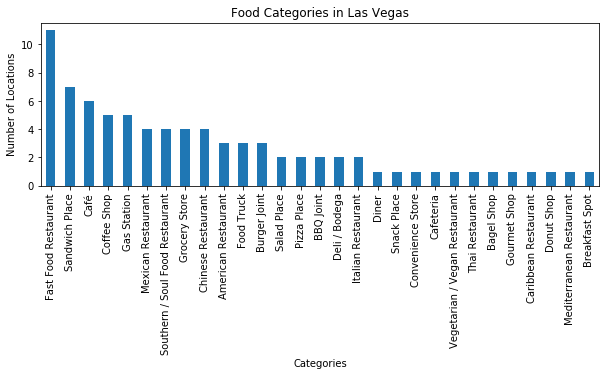

In [383]:
# step 2: plot data
df_categories.plot(kind='bar', figsize=(10, 3))

plt.xlabel('Categories') # add to x-label to the plot
plt.ylabel('Number of Locations') # add y-label to the plot
plt.title('Food Categories in Las Vegas') # add title to the plot

plt.show()

<p>25,759 total people in 89106, 6569 people in need 25.5 percent of people, 80 food locations in zip code, reduce food waste and reduce food insecurities by giving out a meal</p>

<p>One meal each reduces people in need to 6509 and percent of people in area to 25.27</p>
<p>5 meals each reduces people in need to 6169 and percent of people in area to 23.95</p>
<p>10 meals each reduces people in need to 5769 and percent of people in area to 22.4</p>

<p>Food Businesses near and in 89106</p>

In [385]:
df_categoriesa = dffood.loc[dffood.postalCode == '89106', 'categories'].count()

In [386]:
df_categoriesa

81

In [387]:
df_categoriesb = dffood.loc[dffood.postalCode == '89032', 'categories'].count()

In [388]:
df_categoriesb

19

In [389]:
df_categoriesc = dffood.loc[dffood.postalCode == '89101', 'categories'].count()

In [390]:
df_categoriesc

194

In [391]:
df_categoriesd = dffood.loc[dffood.postalCode == '89108', 'categories'].count()

In [392]:
df_categoriesd

16

In [393]:
df_categoriese = dffood.loc[dffood.postalCode == '89107', 'categories'].count()

In [394]:
df_categoriese

60

In [395]:
df_categoriesf = dffood.loc[dffood.postalCode == '89104', 'categories'].count()

In [396]:
df_categoriesf

115

In [397]:
df_categoriesg = dffood.loc[dffood.postalCode == '89102', 'categories'].count()

In [398]:
df_categoriesg

187

In [399]:
df_catnear = df_categoriesa + df_categoriesb + df_categoriesc + df_categoriesd + df_categoriese + df_categoriesf + df_categoriesg

In [400]:
df_catnear

672

<p>25,759 total people in 89106, 6569 people in need 25.5 percent of people, 672 food locations surrounding the West Las Vegas area, reduce food waste and reduce food insecurities by giving out a meal</p>

<p>One meal each reduces people in need to 5897 and percent of people in area to 22.89</p>
<p>2 meals each reduces people in need to 5225 and percent of people in area to 20.28</p>
<p>5 meals each reduces people in need to 3209 and percent of people in area to 12.46</p>

<h1>Analyze each neighborhood</h1>

In [219]:
# one hot encoding
categories_onehot = pd.get_dummies(datamerge[['categories']], prefix="", prefix_sep="")

# # add neighborhood column back to dataframe
# toronto_onehot['Neighborhood'] = dtvenues_venues['Neighborhood'] 

# # move neighborhood column to the first column
# fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
# toronto_onehot = toronto_onehot[fixed_columns]

categories_onehot.head()

,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Big Box Store,Breakfast Spot,Buffet,Burger Joint,Cafeteria,Café,Cajun / Creole Restaurant,Chinese Restaurant,Coffee Shop,Cuban Restaurant,Deli / Bodega,Diner,Donut Shop,English Restaurant,Fast Food Restaurant,Food,Food Court,Food Truck,Fried Chicken Joint,Gastropub,Golf Course,Grocery Store,Hawaiian Restaurant,Hot Dog Joint,Italian Restaurant,Japanese Restaurant,Market,Mexican Restaurant,New American Restaurant,Pharmacy,Pizza Place,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Shopping Mall,Snack Place,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Supermarket,Taco Place,Thai Restaurant,Vietnamese Restaurant
0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<p>Examine new dataframe shape</p>

In [220]:
categories_onehot.shape

(499, 49)

<p>Group by neighborhood and take mean frequency of category</p>

In [221]:
categories_grouped = categories_onehot.mean().reset_index()
categories_grouped

,index,0
0,American Restaurant,0.190381
1,Asian Restaurant,0.002004
2,BBQ Joint,0.004008
3,Bagel Shop,0.002004
4,Bakery,0.002004
5,Big Box Store,0.002004
6,Breakfast Spot,0.010020
7,Buffet,0.004008
8,Burger Joint,0.010020
9,Cafeteria,0.002004


<p>Confirm new size</p>

In [222]:
categories_grouped.shape

(49, 2)

<p>Print each neighborhood with top 5 common venues</p>

In [226]:
num_top_venues = 5

for hood in categories_grouped['index']:
    print("----"+hood+"----")
    temp = categories_grouped[categories_grouped['index'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 6})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----American Restaurant----
  venue      freq
0     0  0.190381


----Asian Restaurant----
  venue      freq
0     0  0.002004


----BBQ Joint----
  venue      freq
0     0  0.004008


----Bagel Shop----
  venue      freq
0     0  0.002004


----Bakery----
  venue      freq
0     0  0.002004


----Big Box Store----
  venue      freq
0     0  0.002004


----Breakfast Spot----
  venue     freq
0     0  0.01002


----Buffet----
  venue      freq
0     0  0.004008


----Burger Joint----
  venue     freq
0     0  0.01002


----Cafeteria----
  venue      freq
0     0  0.002004


----Café----
  venue      freq
0     0  0.008016


----Cajun / Creole Restaurant----
  venue      freq
0     0  0.002004


----Chinese Restaurant----
  venue      freq
0     0  0.006012


----Coffee Shop----
  venue      freq
0     0  0.002004


----Cuban Restaurant----
  venue      freq
0     0  0.002004


----Deli / Bodega----
  venue      freq
0     0  0.002004


----Diner----
  venue      freq
0     0  0.006012



<p>Put this in dataframe</p>

In [230]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [233]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['index']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
categories_venues_sorted = pd.DataFrame(columns=columns)
categories_venues_sorted['index'] = categories_grouped['index']

for ind in np.arange(categories_grouped.shape[0]):
    categories_venues_sorted.iloc[ind, 1:] = return_most_common_venues(categories_grouped.iloc[ind, :], num_top_venues)

categories_venues_sorted.head()

,index,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,American Restaurant,0,0,0,0,0,0,0,0,0,0
1,Asian Restaurant,0,0,0,0,0,0,0,0,0,0
2,BBQ Joint,0,0,0,0,0,0,0,0,0,0
3,Bagel Shop,0,0,0,0,0,0,0,0,0,0
4,Bakery,0,0,0,0,0,0,0,0,0,0


<p>Cluster Neighborhoods</p>

In [234]:
# set number of clusters
kclusters = 5

categories_grouped_clustering = categories_grouped.drop('index', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(categories_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 3, 3, 3, 3, 3, 0, 3, 0, 3])

<p>New dataframe for Clusters</p>

In [235]:
# add clustering labels
categories_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

categories_merged = datamerge

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
categories_merged = categories_merged.join(categories_venues_sorted.set_index('index'), on='index')

categories_merged.head() # check the last columns!

KeyError: 'index'

<p>Visualize Clusters</p>

In [58]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighborhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

<p>Examine Clusters</p>

<h1>Cluster 1</h1>

In [59]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 0, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Downtown Toronto,0,Coffee Shop,Restaurant,Pub,Café,Italian Restaurant,Bakery,Pizza Place,Gastropub,Breakfast Spot,Butcher
2,Downtown Toronto,0,Coffee Shop,Japanese Restaurant,Sushi Restaurant,Gay Bar,Restaurant,Men's Store,Hotel,Gastropub,Fast Food Restaurant,Dance Studio
3,Downtown Toronto,0,Coffee Shop,Pub,Park,Bakery,Café,Gym / Fitness Center,Theater,Mexican Restaurant,Restaurant,Breakfast Spot
4,Downtown Toronto,0,Coffee Shop,Clothing Store,Cosmetics Shop,Café,Middle Eastern Restaurant,Diner,Bakery,Sporting Goods Shop,Plaza,Bookstore
5,Downtown Toronto,0,Coffee Shop,Restaurant,Café,Hotel,Italian Restaurant,Cosmetics Shop,Gastropub,Breakfast Spot,Clothing Store,Beer Bar
6,Downtown Toronto,0,Coffee Shop,Cocktail Bar,Bakery,Seafood Restaurant,Beer Bar,Cheese Shop,Café,Steakhouse,Farmers Market,Park
7,Downtown Toronto,0,Coffee Shop,Ice Cream Shop,Italian Restaurant,Café,Sandwich Place,Burger Joint,Middle Eastern Restaurant,Spa,Indian Restaurant,Japanese Restaurant
8,Downtown Toronto,0,Coffee Shop,Café,Bar,Steakhouse,Thai Restaurant,Cosmetics Shop,Restaurant,American Restaurant,Hotel,Burger Joint
9,Downtown Toronto,0,Coffee Shop,Hotel,Aquarium,Café,Brewery,Scenic Lookout,Fried Chicken Joint,Music Venue,Park,Sporting Goods Shop
10,Downtown Toronto,0,Coffee Shop,Café,Hotel,Restaurant,Bar,Gastropub,Bakery,Deli / Bodega,American Restaurant,Italian Restaurant


<h1>Cluster 2</h1>

In [60]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 1, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Downtown Toronto,1,Park,Playground,Trail,Building,Wings Joint,Deli / Bodega,Eastern European Restaurant,Dumpling Restaurant,Donut Shop,Doner Restaurant


<h1>Cluster 3</h1>

In [61]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
14,Downtown Toronto,2,Airport Service,Airport Lounge,Boutique,Harbor / Marina,Airport,Airport Food Court,Airport Gate,Airport Terminal,Sculpture Garden,Bar


<h1>Cluster 4</h1>

In [62]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 3, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
12,Downtown Toronto,3,Café,Japanese Restaurant,Bar,Bakery,Restaurant,Bookstore,Sandwich Place,Chinese Restaurant,Italian Restaurant,Dessert Shop
13,Downtown Toronto,3,Café,Vegetarian / Vegan Restaurant,Bar,Vietnamese Restaurant,Mexican Restaurant,Dumpling Restaurant,Chinese Restaurant,Bakery,Coffee Shop,Burger Joint


<h1>Cluster 5</h1>

In [63]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 4, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
17,Downtown Toronto,4,Grocery Store,Café,Park,Baby Store,Athletics & Sports,Restaurant,Bank,Diner,Nightclub,Convenience Store
